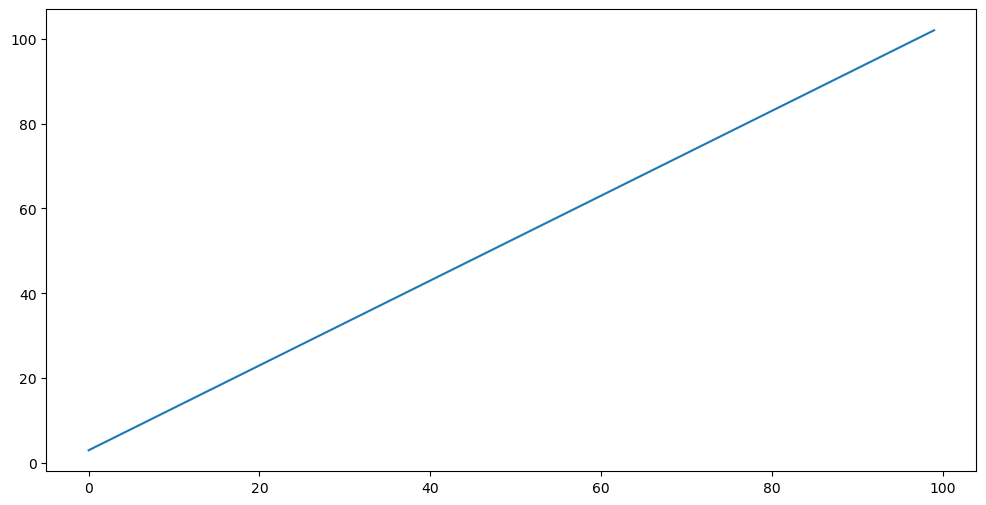

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##lineAndRandomPoints
import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12,6))
plt.plot(line)
plt.show()
line

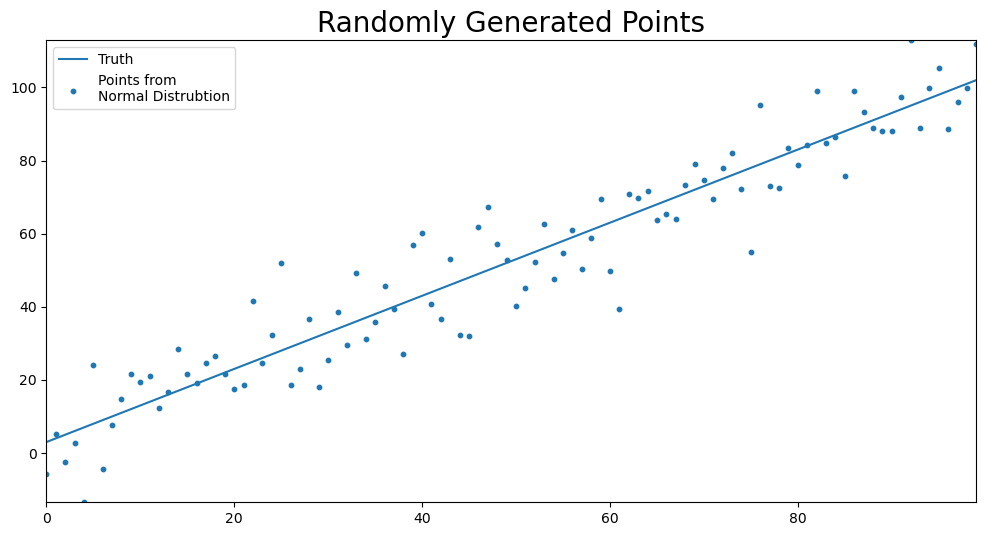

In [2]:
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10))

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.plot(line, label ="Truth")
plt.scatter(np.arange(len(points)), points, s = 10,
           label = "Points from\nNormal Distrubtion")
plt.title("Randomly Generated Points", fontsize = 20)
plt.legend(loc = "best")
plt.show()

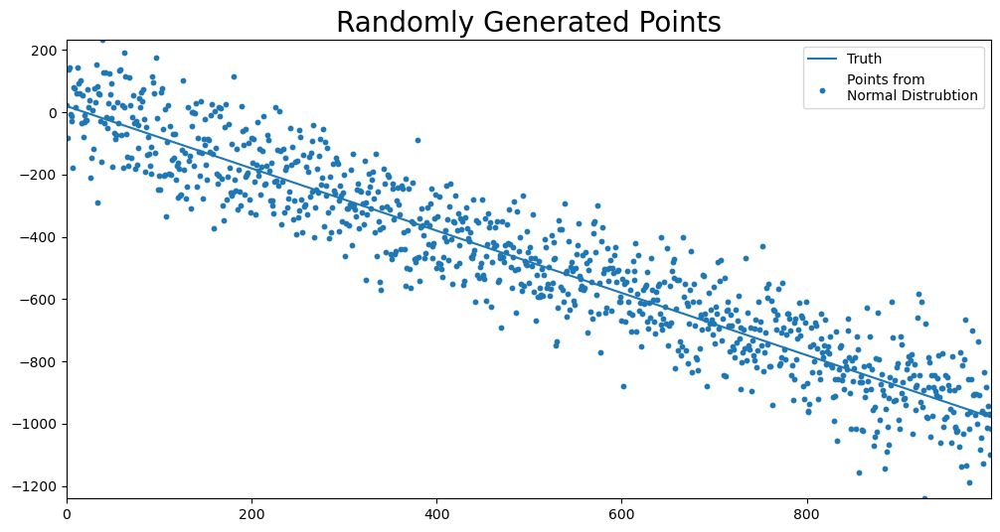

In [3]:
import random

def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):
    line = np.array([slope * i + y_int for i in range(line_length)])    
    points = []
    for point in line:
        points.append(random.normalvariate(point, SD))
        
    return line, points

def plot_line(line, points, line_name = "Truth",
              title = "Randomly Generated Points"):

    figure = plt.figure(figsize = (12, 6))
    plt.rcParams["axes.xmargin"] = 0
    plt.rcParams["axes.ymargin"] = 0
    plt.plot(line, label =line_name)
    plt.scatter(np.arange(len(points)), points, s = 10,
               label = "Points from\nNormal Distrubtion")
    plt.title("Randomly Generated Points", fontsize = 20)
    plt.legend(loc = "best")
    plt.show()
    
line, points = build_random_data_with_line(y_int = 20, slope = -1, SD = 100, line_length = 1000)
plot_line(line, points)

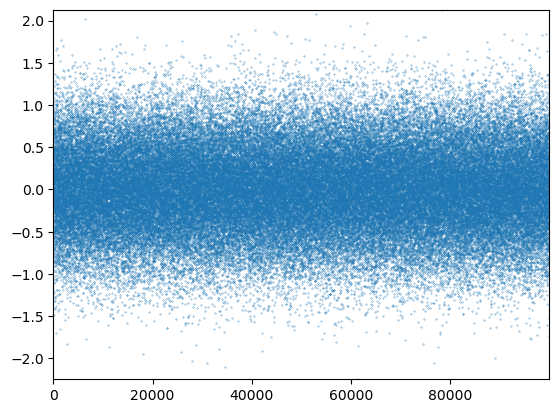

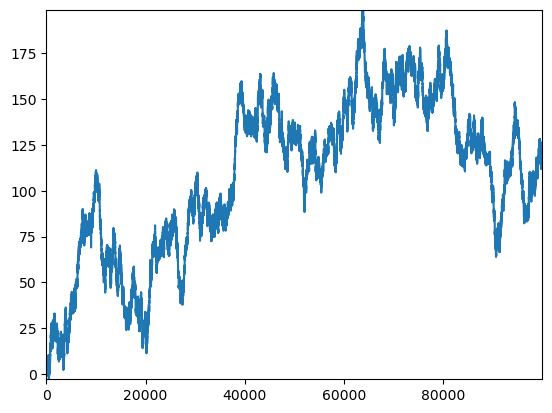

In [4]:
#montecarloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random


mu = 0
#SD is sigma, variance is sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu, sigma))

plt.plot(random_list, ls = "",linewidth = 1, marker =".", markersize = .5)
plt.show()
plt.close()

simulation = [] 

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1] + val)
        
plt.plot(simulation)
plt.show()
plt.close()



In [5]:
def run_monte_carlo(mean, sigma, num_sims, sim_dict, index):
    
    for i in range(num_sims):
        sim_dict[i] = {}
        for ix in index:
            sim_dict[i][ix] = random.normalvariate(mean, sigma)


In [6]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
index = np.arange(2000)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.074993,-0.111514,1.093659,0.892505,-0.760294,-0.356006,0.193036,-0.271986,-0.485503,2.204915,...,1.875455,-2.016194,1.697301,1.004512,-0.231166,-1.292893,0.998944,1.101175,0.525073,-0.364628
1,0.338305,-1.449905,0.878124,0.808783,0.268848,-1.612231,-0.179395,-1.608053,-0.229769,0.431206,...,-0.200464,0.440241,0.211279,0.729988,-0.969304,0.165549,-1.848574,0.491293,0.152021,-1.630379
2,-0.117472,0.895101,-0.279409,-0.892038,0.119405,-0.718373,-0.792900,1.936939,-1.735103,0.458577,...,-0.793206,-0.609043,-1.024452,0.132124,0.117865,0.566860,0.912245,-1.436734,-0.238928,-1.635349
3,1.397785,0.649617,0.268755,-0.939712,-2.041411,-0.837906,0.117590,1.311338,-0.467624,1.566490,...,-1.312619,-1.293767,-0.001822,3.097314,-1.230518,0.821099,0.926678,-0.451023,-0.396944,1.094276
4,0.386832,0.309029,-1.622149,-0.166859,0.623462,0.526553,-0.908979,1.259936,-1.018864,-0.375490,...,-0.030018,1.112759,0.434809,-0.017299,-1.144377,0.672975,-2.133504,0.083852,2.520919,-0.013638
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-0.198377,0.612378,-0.828735,1.061833,0.149687,0.253897,0.837039,0.142734,0.843083,-1.078326,...,-0.994313,0.004073,-0.220633,1.370573,-0.698942,1.364196,1.125373,-1.565614,0.247519,0.786184
1996,-0.092166,-0.482331,-0.146529,-0.748072,-1.280106,0.517965,1.075073,-0.784503,-1.999190,0.155314,...,1.451735,1.976523,-0.393379,0.715384,-1.838088,1.226036,1.097940,0.432519,0.284680,-0.851388
1997,-0.962372,0.782505,1.425090,-2.150558,0.026941,-0.966398,-0.478867,2.592046,-2.333269,0.912421,...,-1.145531,-0.556718,0.716822,-0.104172,0.486766,-0.290445,-0.901125,1.006284,1.461315,0.154417
1998,0.936537,-0.430508,0.160581,-0.055853,0.856824,-0.652646,1.610401,0.366559,1.212341,-1.091158,...,-1.767136,0.508851,0.179629,1.726316,0.181743,-0.556426,0.049002,-0.466319,0.774414,0.182080


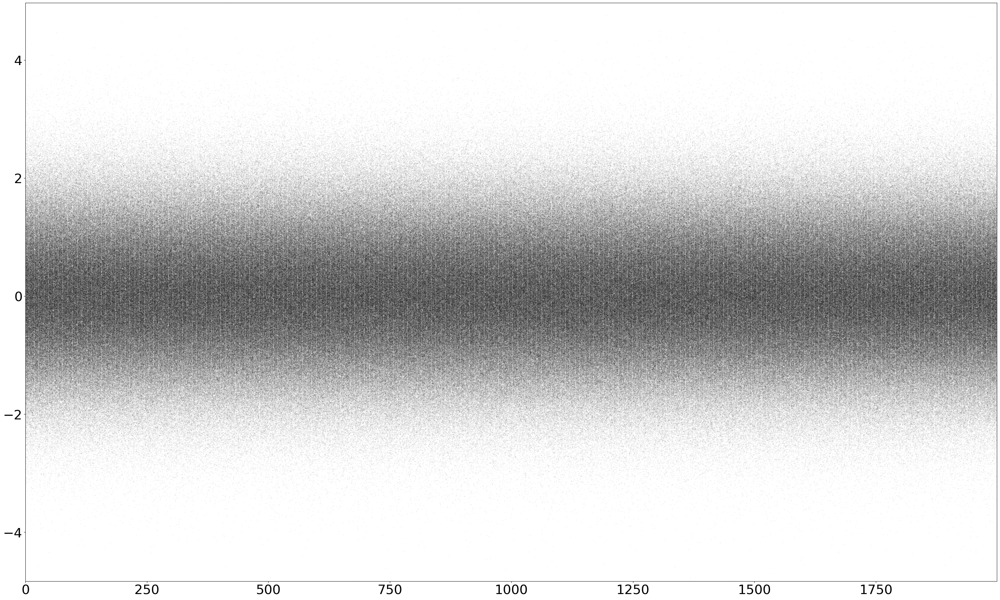

In [7]:
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.rcParams["font.size"] = 30

fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, ls = " ", marker=".", markersize = .2, 
                            color ="k", alpha = .5, ax = ax)

plt.show()

C:\Users\JLCat\AppData\Local\Temp\ipykernel_27556\667913757.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])


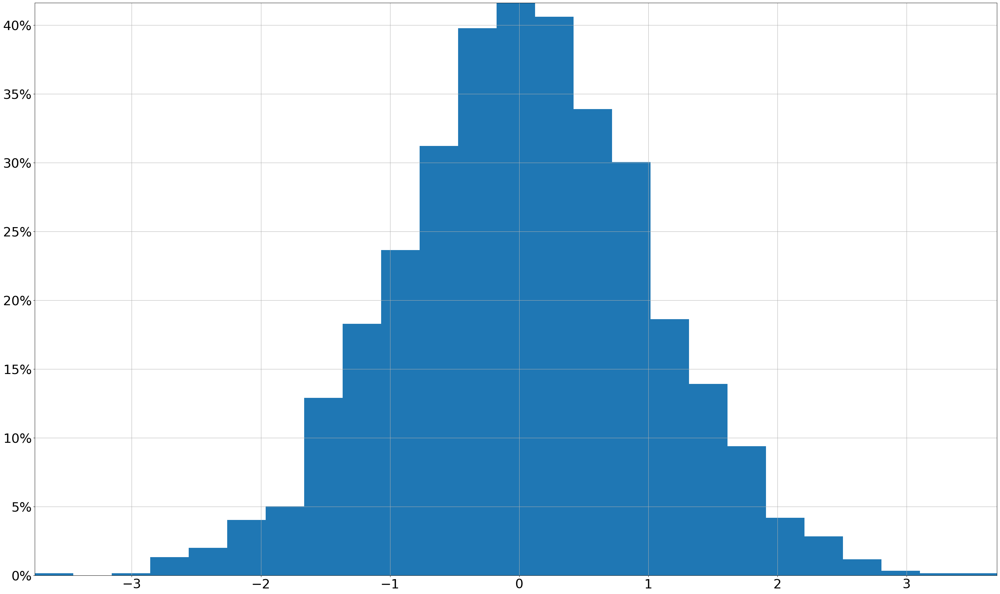

In [8]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.iloc[-1].hist(bins = 25, density = True,
                                ax = ax)

# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()

## Monte Carlo with a Positive Trend

In [9]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 2000
index = np.arange(periods)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).cumsum()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.997478,-0.006966,0.635781,-1.942693,-0.131907,-0.651159,0.070804,-0.023135,0.177340,0.217694,...,0.077938,-0.626282,0.465784,-0.066015,0.644121,-0.786859,0.548832,-0.858787,-0.659783,0.002314
1,-1.613370,-0.540252,0.031667,-1.052882,0.585891,-0.719436,0.478187,-0.067816,0.757427,-0.030885,...,0.488475,-0.343395,0.414386,0.577396,0.864497,0.231001,0.684729,-1.540068,-0.523816,-0.592066
2,-1.552664,-0.959160,-0.126949,-0.075041,0.792647,-0.667562,-0.138895,-0.200552,1.216853,0.554090,...,-0.082508,-0.954437,0.390437,0.942620,-0.136308,-0.181931,-0.111660,-1.245305,-1.083721,-1.045247
3,-1.609133,-0.676207,-0.967548,-0.333640,1.453098,0.009965,0.280521,0.434389,1.317756,0.647465,...,-0.498759,-1.810446,0.400528,-0.655169,0.187402,-0.781973,-0.494049,-0.778308,-0.658566,-1.488882
4,-2.110294,-0.345386,-0.192039,0.557040,1.284901,-0.016729,0.049079,1.089991,1.235906,0.838486,...,-0.635197,-0.771668,1.269880,-1.152545,0.536609,-0.946879,0.204194,-0.541304,-0.934245,-1.303117
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,67.104270,56.477885,98.841347,88.661060,57.885563,80.878166,87.793945,119.566358,102.070753,126.630221,...,93.229172,56.202399,108.863789,94.104566,109.153395,101.140390,102.850794,50.524765,139.973451,91.256694
1996,67.444604,56.599121,98.503592,89.147392,58.514516,80.410726,87.835337,119.655048,102.003447,126.430763,...,93.903241,55.782798,108.610795,93.614097,109.363272,101.122370,102.403426,50.458202,140.047257,91.789671
1997,67.341225,56.963604,99.318703,89.308146,59.136195,80.157311,87.798139,119.885544,101.231067,126.662597,...,93.426004,55.744548,108.738999,92.822996,109.527194,100.802275,102.243342,51.135528,140.609256,92.002535
1998,67.876832,57.694039,100.047329,89.541952,58.876598,80.225407,87.803053,119.128383,100.828770,127.037722,...,93.489446,56.139342,109.037768,92.979039,109.321509,100.903675,101.620315,51.424101,141.277096,91.713321


In [10]:
def plot_monte_carlo_sim(sim_data,  title = None, logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop("mean", inplace = False, axis = 1).plot.line(
            legend=False, ls = "", marker =".", markersize = .1, color = "k", 
        alpha = .05, logy = logy, ax = ax)
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

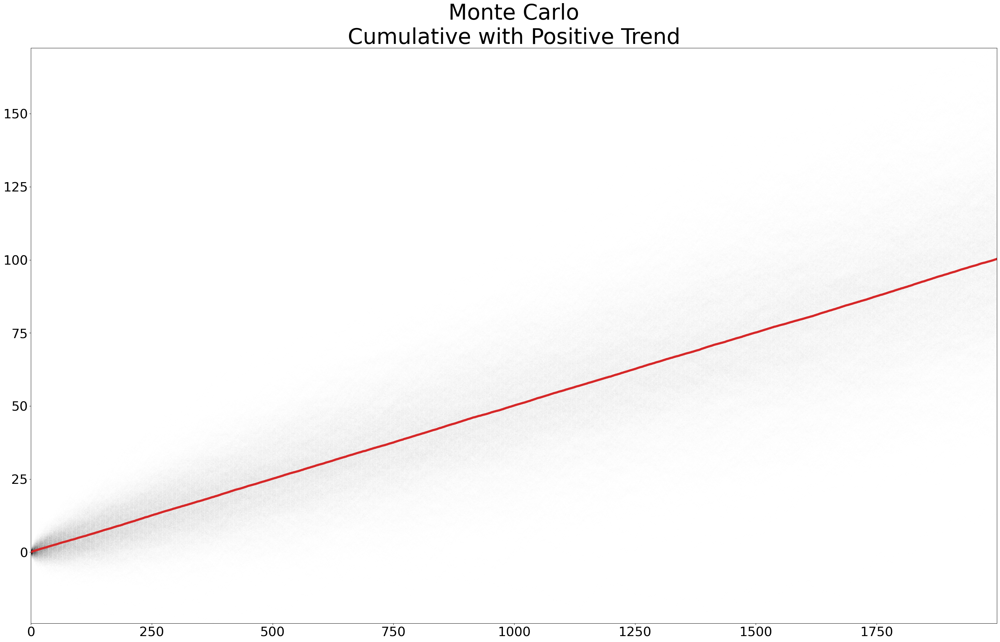

In [11]:
plot_monte_carlo_sim(monte_carlo_sim_df,  
    title = "Monte Carlo\nCumulative with Positive Trend", logy = False)


### Calculating Expected Value

In [12]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0         0.053174
1         0.091275
2         0.152539
3         0.221828
4         0.288156
           ...    
1995    100.105970
1996    100.145706
1997    100.199284
1998    100.260432
1999    100.333218
Name: mean, Length: 2000, dtype: float64

### Simulating Changes in Portfolio Values

In [13]:
import pandas_datareader.data as web
import datetime
import yfinance  as yf
yf.pdr_override()

start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = "MSFT", "AAPL", "IBM", "GOOG"
for name in stocks:
    data_dict[name] =web.get_data_yahoo(name, start, end)

# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [14]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,NaN,NaN,NaN,NaN
2005-01-04,0.003740,0.010270,-0.010742,-0.040501
2005-01-05,-0.002235,0.008758,-0.002068,-0.005090
2005-01-06,-0.001120,0.000775,-0.003109,-0.025632
2005-01-07,-0.002991,0.072811,-0.004366,0.028109
...,...,...,...,...
2024-04-09,0.003980,0.007243,-0.002687,0.012809
2024-04-10,-0.007085,-0.011139,-0.017273,-0.003035
2024-04-11,0.011033,0.043271,-0.000753,0.019853


In [15]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace =True)
close_data_normalized

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499
2005-01-05,1.001496,1.019118,0.987212,0.954615
2005-01-06,1.000374,1.019908,0.984143,0.930146
2005-01-07,0.997382,1.094169,0.979847,0.956292
...,...,...,...,...
2024-04-09,15.941661,150.126653,2.025762,31.322132
2024-04-10,15.828722,148.454353,1.990771,31.227061
2024-04-11,16.003366,154.878109,1.989273,31.847005


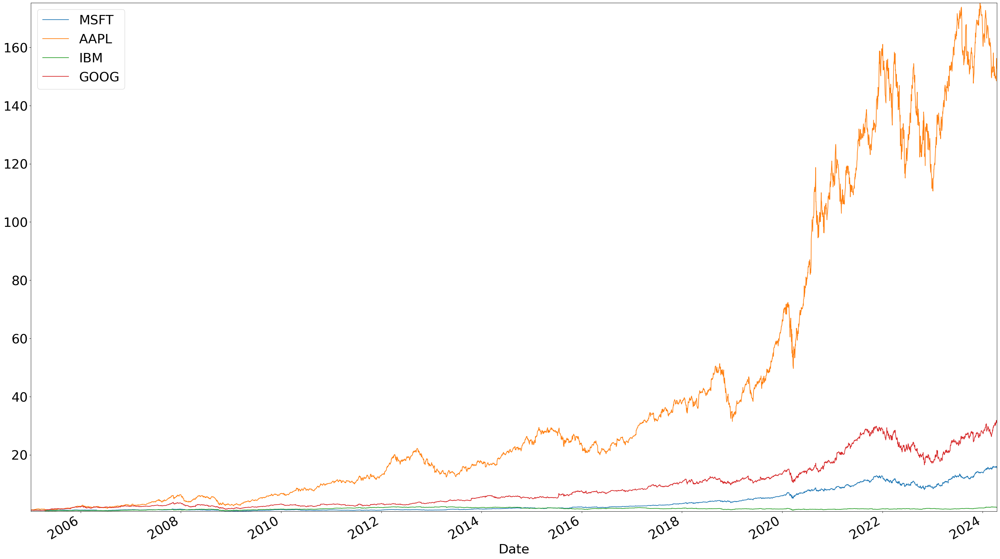

In [16]:
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax = ax)
plt.show()
plt.close()

### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$
>
>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$
>
>$t$ is measured in days

In [17]:
mean_var_df = pd.DataFrame(
    {"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (
        1 / close_data_normalized["MSFT"].count()) - 1, 
                            "sigma" : close_data_pct_change.std()})
mean_var_df

,mean,sigma
MSFT,0.000565,0.017242
AAPL,0.001037,0.020437
IBM,0.000137,0.014441
GOOG,0.000708,0.018958


In [18]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock]   
    run_monte_carlo(mean, 
                    sigma, 
                    num_sims, 
                    monte_carlo_sim_dict[stock], 
                    dates)
#    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dfs = {stock: pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod() for stock in stocks}

In [19]:
monte_carlo_sim_dfs

{'MSFT':                   0          1         2         3         4          5    \
 2005-01-03   1.015233   0.974473  1.010087  0.981386  1.028885   0.977511   
 2005-01-04   1.010780   0.964555  1.020144  0.966004  1.036349   0.982583   
 2005-01-05   1.019523   0.973034  1.019502  0.981885  1.049124   0.948876   
 2005-01-06   0.990305   1.001056  1.027539  0.979569  1.056292   0.921054   
 2005-01-07   0.990908   1.009534  1.039986  0.961268  1.112237   0.930806   
 ...               ...        ...       ...       ...       ...        ...   
 2024-04-09  17.140051  13.045969  1.168467  5.797952  5.581665  16.263896   
 2024-04-10  16.851446  12.996918  1.192110  5.788323  5.521045  16.311615   
 2024-04-11  16.562154  12.860880  1.181049  5.750699  5.687267  16.204705   
 2024-04-12  17.067793  12.616109  1.214948  5.910111  5.504143  15.710058   
 2024-04-15  17.032434  12.702565  1.227283  5.820107  5.436937  15.537525   
 
                  6         7          8          9   

In [20]:
def plot_monte_carlo_sim(sim_data, 
                         observed_data = None, 
                         title = None, 
                         logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)    
    index = sim_data.index
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop(["mean"], inplace = False, axis = 1).plot.line(
            legend=False, marker =".",
        markersize = .1, 
        color = "k", 
        alpha = .05, 
        logy = logy, 
        ax = ax)
    if observed_data is not None:
        observed_data.plot.line(legend = False, 
                                color = "C2", 
                                linewidth = 5, 
                                logy = logy, 
                                ax = ax)
    
        # find x coordinate of lowest value observed
        obs_text_x = observed_data[observed_data == observed_data.min()].index
        plt.text(obs_text_x, observed_data.loc[obs_text_x] * .7,
                 "Observed", fontsize = 70, color = "C2")
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    plt.text(index[-400], sim_data["mean"].iloc[-400] * 1.5, "Exp\nVal",
            fontsize = 70, color = "C3")
   
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

In [21]:
monte_carlo_sim_dfs[stock].median(axis = 1)

2005-01-03     1.001103
2005-01-04     1.000709
2005-01-05     1.002732
2005-01-06     1.001257
2005-01-07     1.003386
                ...    
2024-04-09    12.016397
2024-04-10    11.840676
2024-04-11    11.929822
2024-04-12    12.015471
2024-04-15    11.936697
Length: 4853, dtype: float64

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

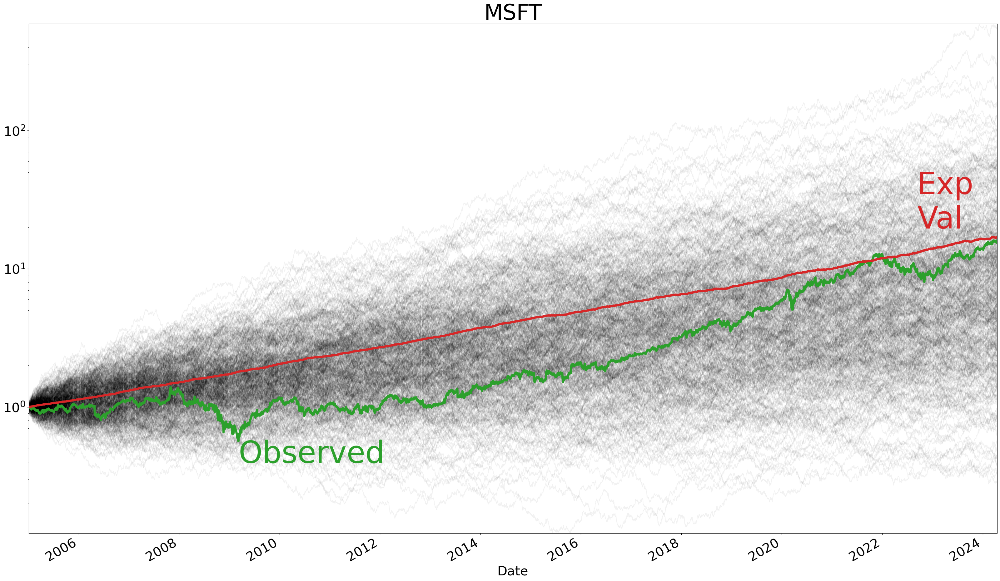

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

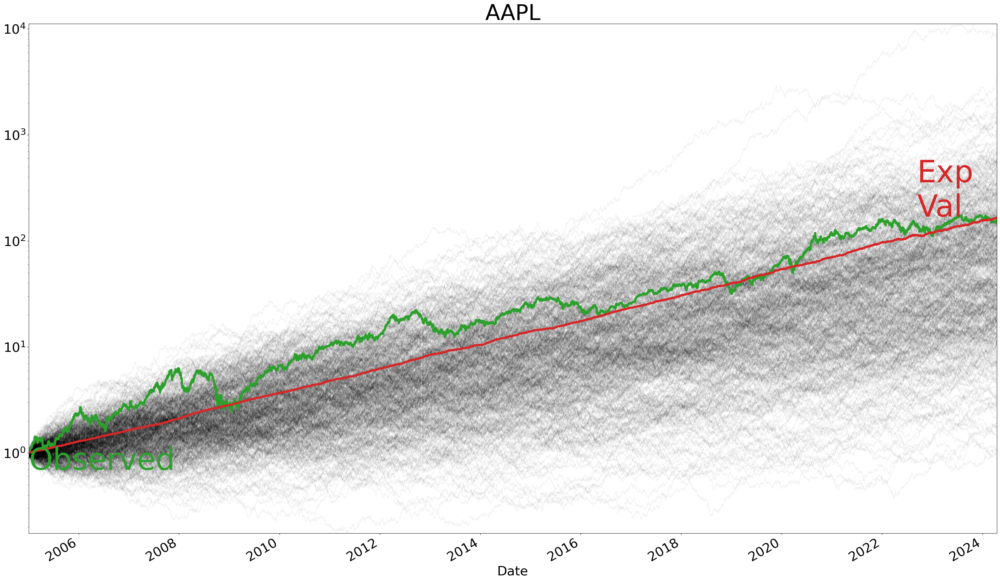

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

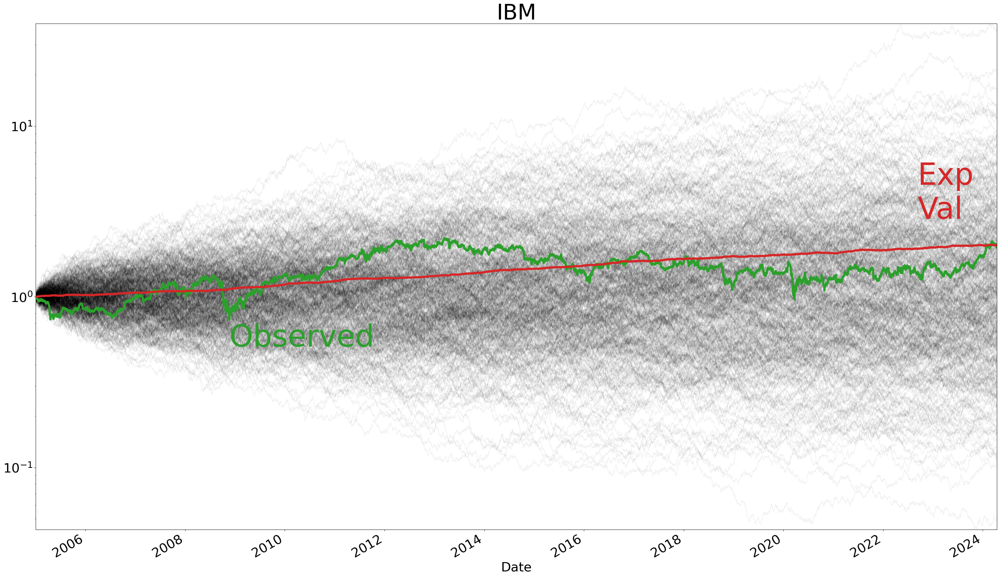

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

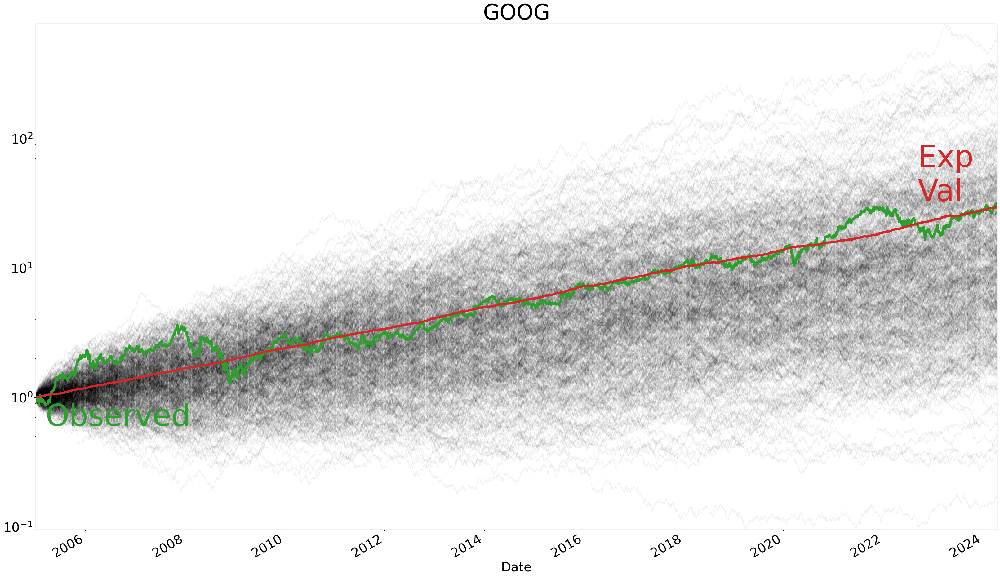

In [22]:
for stock in stocks:
    plot_monte_carlo_sim(monte_carlo_sim_dfs[stock], 
                         close_data_normalized[stock], 
                         stock, 
                         logy= True)


## Calculate Portfolio Return

In [23]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [24]:
ex_return = pd.DataFrame(close_data_normalized.apply(lambda x :x.mul(portfolio_weights[x.name]),
                                                     axis = 0).sum(axis=1),
                                                    columns = ["Portfolio Return"])
close_data_normalized["Portfolio Return"] = ex_return
close_data_normalized

,MSFT,AAPL,IBM,GOOG,Portfolio Return
Date,,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499,0.990692
2005-01-05,1.001496,1.019118,0.987212,0.954615,0.990610
2005-01-06,1.000374,1.019908,0.984143,0.930146,0.983643
2005-01-07,0.997382,1.094169,0.979847,0.956292,1.006923
...,...,...,...,...,...
2024-04-09,15.941661,150.126653,2.025762,31.322132,49.854052
2024-04-10,15.828722,148.454353,1.990771,31.227061,49.375226
2024-04-11,16.003366,154.878109,1.989273,31.847005,51.179438


<Axes: xlabel='Date'>

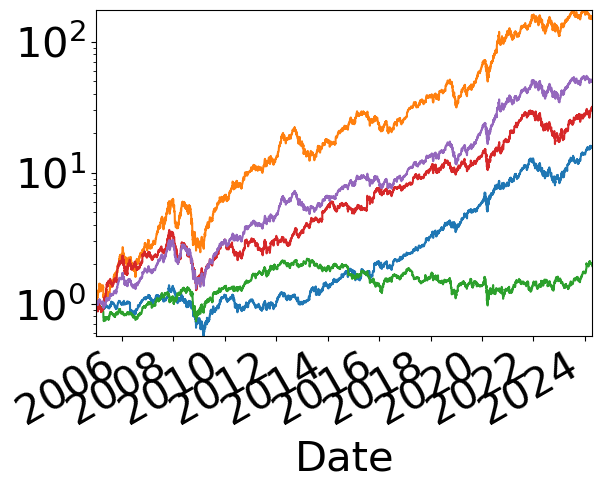

In [25]:
close_data_normalized.plot.line(legend=False, logy = True)

In [26]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001298
...,...
2024-04-09,0.007749
2024-04-10,-0.009605
2024-04-11,0.036541


In [27]:
mean_var_df = pd.DataFrame({"mean": (
    ex_return.iloc[-1] / ex_return.iloc[0]) **(
        1 / ex_return["Portfolio Return"].count()) -1,
                           "sigma" : ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000808,0.016563


In [28]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]
run_monte_carlo(mean, 
                sigma, 
                num_sims, 
                monte_carlo_sim_dict, 
                dates)
monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,1.024030,1.006724,1.005970,1.037218,0.981622,0.982501,0.981168,0.990527,0.996167,0.985555,...,1.010658,1.008636,0.999479,0.986212,1.001635,0.986635,0.989412,0.991359,0.985122,1.020960
2005-01-04,1.038843,1.013378,0.983933,1.026754,1.003487,0.975091,0.999125,0.984050,0.983428,0.983308,...,1.031669,0.996644,0.986157,0.975405,0.992574,0.999137,0.978065,0.991072,0.993308,1.010370
2005-01-05,1.057730,1.017537,0.970198,1.029427,0.956406,0.968437,0.995014,0.961438,0.975563,1.000325,...,1.053966,1.001510,0.985074,0.991572,1.028113,0.998592,0.956949,1.002609,0.997108,0.976518
2005-01-06,1.026904,1.002674,0.969654,1.012394,0.971390,0.963541,1.016903,0.962740,0.973889,1.041227,...,1.033896,1.038743,0.987850,0.983088,1.037088,0.981744,0.997718,0.993183,1.010347,0.992076
2005-01-07,1.018683,1.007796,0.980631,1.029988,0.974043,0.963876,1.028039,0.971632,0.966821,1.014807,...,1.036557,1.040974,1.002470,0.972135,1.018822,0.997262,0.987353,0.967893,0.993396,0.979598
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-09,16.303400,21.474141,163.718099,583.673123,89.683448,12.814472,41.153214,132.245561,414.150230,12.017762,...,41.869600,15.333827,27.209381,17.217993,15.577341,3.252207,27.919891,40.117015,120.811714,29.207110
2024-04-10,16.504779,21.551155,163.999291,571.994920,89.184474,12.738976,41.273541,132.727575,419.125458,12.383687,...,42.565572,14.878121,28.149118,16.855366,15.559807,3.322127,27.821573,41.025698,120.191895,28.320989
2024-04-11,16.479986,21.451877,165.917026,561.658829,90.082863,12.691553,41.817710,134.030538,420.566594,12.062395,...,42.510942,14.730527,26.960505,17.159809,15.377284,3.342168,27.734553,41.792409,118.540830,27.627309
2024-04-12,16.766206,21.630144,164.199085,565.584699,90.030084,12.755212,40.882387,135.815548,420.985685,12.236014,...,42.490010,14.904790,26.988309,16.971662,15.254224,3.374511,27.642073,42.093913,115.483207,28.545224


C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

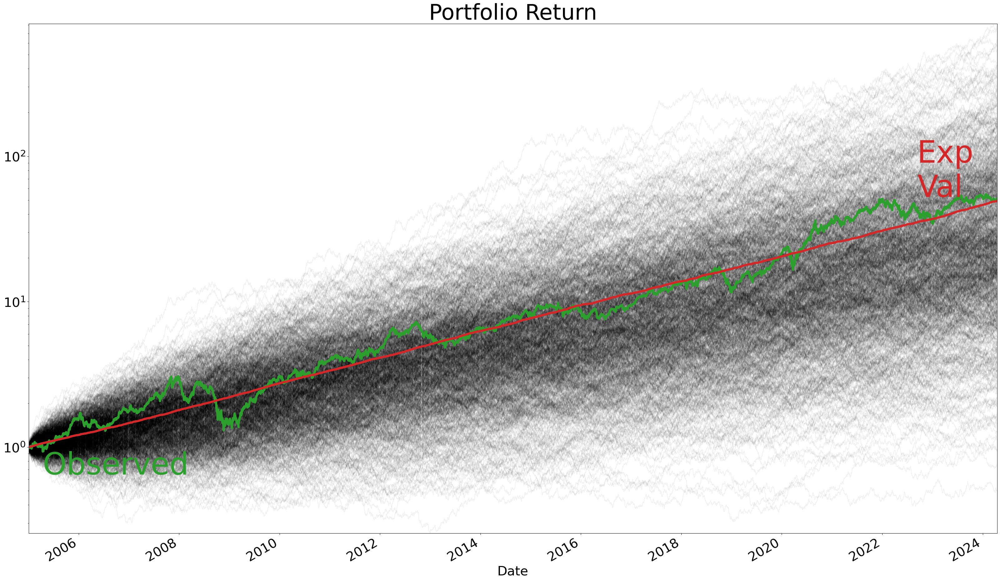

In [29]:
plot_monte_carlo_sim(monte_carlo_sim_df, 
                     ex_return["Portfolio Return"], 
                     "Portfolio Return", 
                     logy= True)